# Experiment KPI Analysis

## Table of Contents

* [Process KPIs](#Process-KPIs)
* [Sensitivity Analysis](#Sensitivity-Analysis)
* [Control Parameter Analysis and Selection](#Control-Parameter-Analysis-and-Selection)

# Setup and Dependencies

In [12]:
# Set project root folder, to enable importing project files from subdirectories
from pathlib import Path
import os

path = Path().resolve()
root_path = str(path).split('notebooks')[0]
os.chdir(root_path)

# Force reload of project modules, sometimes necessary for Jupyter kernel
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [13]:
import pandas as pd
from pandarallel import pandarallel
pandarallel.initialize(progress_bar=False)

INFO: Pandarallel will run on 8 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.


In [14]:
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
# import plotly.io as pio
#pio.renderers.default = "png"
from pprint import pprint

In [15]:
# Update dataframe display settings
pd.set_option('display.max_columns', 100)
pd.set_option('display.max_rows', 50)
pd.options.plotting.backend = "plotly"

# Load Dataset

In [16]:
from experiments.system_model_v3.post_process import post_process_results
from experiments.system_model_v3.experiment_monte_carlo import SIMULATION_TIMESTEPS, params
from radcad.core import generate_parameter_sweep


* Number of timesteps: 4320 / 180.0 days
* Number of MC runs: 5
* Timestep duration: 0.004 seconds
* Control parameters: ['controller_enabled', 'kp', 'ki', 'control_period', 'liquidity_demand_shock', 'arbitrageur_considers_liquidation_ratio', 'rescale_target_price']
* Number of parameter combinations: 432
* Expected experiment duration: 622.08 minutes / 10.368 hours
    


In [17]:
processed_results = 'experiments/system_model_v3/experiment_monte_carlo/processed_results.hdf5'

In [18]:
df = pd.read_hdf(processed_results, key='results')
df

,timedelta,cumulative_time,timestamp,eth_price,liquidity_demand,liquidity_demand_mean,eth_collateral,eth_locked,eth_freed,principal_debt,rai_drawn,rai_wiped,system_revenue,stability_fee,market_price,market_price_twap,target_price,target_rate,eth_return,eth_gross_return,expected_market_price,expected_debt_price,error_star,error_star_integral,market_slippage,RAI_balance,ETH_balance,UNI_supply,simulation,subset,run,substep,timestep,eth_collateral_value,collateralization_ratio,ki,kp,liquidation_ratio,controller_enabled,control_period,liquidity_demand_shock,arbitrageur_considers_liquidation_ratio,rescale_target_price,target_price_scaled
0,0,0,2017-01-01 00:00:00,294.069151,1.000000,1.000000,154827.528922,154827.528922,0.000000,1.000000e+07,1.000000e+07,0.000000e+00,0.0,1.585490e-10,3.140000,0.000000,3.140000,0.0,0.000000,0.0,3.140000,3.14,0.000000,0.000000,0.000000,1.000000e+07,106777.606153,1.000000e+07,0,0,1,0,0,4.553000e+07,1.450000,-5.000000e-09,2.000000e-07,1.45,True,3600.0,True,True,True,4.553
1,3600,3600,2017-01-01 01:00:00,291.208252,906.674484,453.837242,154827.528922,154827.528922,0.000000,1.450000e+07,1.450000e+07,0.000000e+00,0.0,1.585490e-10,3.139432,0.000000,2.165517,0.0,-0.009729,1.0,3.231162,3.14,3.140000,5652.000000,0.000181,1.450091e+07,73703.760510,1.000000e+07,0,0,1,18,1,4.508705e+07,1.435893,-5.000000e-09,2.000000e-07,1.45,True,3600.0,True,True,True,3.140
2,3600,7200,2017-01-01 02:00:00,292.287792,-326.024615,63.906314,107503.536596,154827.528922,47323.992326,9.970037e+06,1.450000e+07,4.529963e+06,0.0,1.585490e-10,1.480124,0.000000,2.165517,0.0,0.003707,1.0,1.523521,3.14,3.140000,11458.000000,NaN,9.970618e+06,107288.025922,9.999775e+06,0,0,1,18,2,3.142197e+07,1.455375,-5.000000e-09,2.000000e-07,1.45,True,3600.0,True,True,True,3.140
3,3600,10800,2017-01-01 03:00:00,289.343698,209.658450,136.782382,107503.536596,154827.528922,47323.992326,1.000700e+07,1.453696e+07,4.529963e+06,0.0,1.585490e-10,3.145007,0.000000,2.165517,0.0,-0.010073,1.0,3.236929,3.14,3.140000,11616.000000,-1.124826,1.000779e+07,106890.741521,9.999775e+06,0,0,1,18,3,3.110547e+07,1.435395,-5.000000e-09,2.000000e-07,1.45,True,3600.0,True,True,True,3.140
4,3600,14400,2017-01-01 04:00:00,286.827771,-79.844839,28.468771,107503.536596,154827.528922,47323.992326,9.906201e+06,1.453696e+07,4.630759e+06,0.0,1.585490e-10,3.090459,0.000000,2.165517,0.0,-0.008695,1.0,3.181390,3.14,3.140000,11620.000000,0.017344,9.906911e+06,107982.421498,9.999775e+06,0,0,1,18,4,3.083500e+07,1.437392,-5.000000e-09,2.000000e-07,1.45,True,3600.0,True,True,True,3.140
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8711142,3600,15537600,2017-06-29 20:00:00,333.003922,144.042027,11414.400180,43950.155901,164697.920768,120747.764867,3.228395e+06,6.056715e+07,5.733875e+07,0.0,1.585490e-10,4.599548,4.630135,3.140000,0.0,-0.004307,1.0,4.715210,3.14,-1.490135,-5514.485458,NaN,1.899010e+07,261063.604866,2.118011e+07,0,431,5,18,4316,1.463557e+07,1.443755,-2.000000e-10,5.000000e-06,1.45,False,25200.0,False,False,False,4.553
8711143,3600,15541200,2017-06-29 21:00:00,331.275043,-9229.101700,1092.649240,43950.155901,164697.920768,120747.764867,3.214490e+06,6.056715e+07,5.735266e+07,0.0,1.585490e-10,4.582382,4.640406,3.140000,0.0,-0.005192,1.0,4.698362,3.14,-1.500406,-5532.974094,0.003732,1.896697e+07,261382.975946,2.118011e+07,0,431,5,18,4317,1.455959e+07,1.442472,-2.000000e-10,5.000000e-06,1.45,False,25200.0,False,False,False,4.553
8711144,3600,15544800,2017-06-29 22:00:00,331.782012,110.399771,601.524506,43950.155901,164697.920768,120747.764867,3.197801e+06,6.056715e+07,5.736935e+07,0.0,1.585490e-10,4.565235,4.640406,3.140000,0.0,0.001530,1.0,4.683459,3.14,-1.500406,-5551.462730,0.003742,1.895039e+07,261612.340372,2.118011e+07,0,431,5,18,4318,1.458187e+07,1.452219,-2.000000e-10,5.000000e-06,1.45,False,25200.0,False,False,False,4.553
8711145,3600,15548400,2017-0

# Process KPIs

In [19]:
df_kpis = df.copy()

In [20]:
# Rescale target price according to liquidation ratio, if rescale_target_price set
cols = ['timestep', 'target_price', 'liquidation_ratio', 'rescale_target_price']
f = lambda x: (x['target_price'] * x['liquidation_ratio']) if x['rescale_target_price'] and x['timestep'] > 0 else x['target_price']
df_kpis['target_price_scaled'] = df_kpis[cols].parallel_apply(f, axis=1)
df_kpis['target_price_scaled'].head(10)

0    3.14
1    3.14
2    3.14
3    3.14
4    3.14
5    3.14
6    3.14
7    3.14
8    3.14
9    3.14
Name: target_price_scaled, dtype: float64

## Stability

**Stability** threshold of system: defined as the maximum value for relative frequency of simulation runs that are unstable. Unstable is measured as fraction of runs where:
  - market price runs to infinity/zero (e.g. upper bound 10xPI; lower bound 0.10xPI if initial price is PI);
  - redemption price runs to infinity/zero (e.g. upper bound 10xPI; lower bound 0.10xPI if initial price is PI);
  - Uniswap liquidity (RAI reserve) runs to zero;
  - CDP position (total ETH collateral) runs to infinity/zero.

In [21]:
# Get initial target price for calculations
initial_target_price = df_kpis['target_price'].iloc[0]
initial_target_price

3.14

In [22]:
# Get decile stats. for system states, to set KPI thresholds
df_kpis[['market_price', 'target_price_scaled', 'RAI_balance', 'eth_collateral']].describe([0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.90])

,market_price,target_price_scaled,RAI_balance,eth_collateral
count,8.711147e+06,8.711147e+06,8.711147e+06,8.711147e+06
mean,1.486891e+02,2.353649e+00,1.205188e+07,9.662898e+04
std,1.104772e+04,1.127548e+00,8.701426e+06,4.710633e+04
min,3.985592e-03,1.738892e-02,2.276185e+03,5.871264e+03
10%,4.823438e-01,3.890588e-01,5.131811e+06,3.396754e+04
20%,1.262839e+00,1.029916e+00,6.821149e+06,5.015548e+04
30%,2.053286e+00,1.837509e+00,8.071490e+06,7.021243e+04
40%,2.902159e+00,2.792804e+00,8.949617e+06,9.045166e+04
50%,3.350532e+00,3.140000e+00,9.900816e+06,1.044786e+05
60%,4.278496e+00,3.140000e+00,1.104458e+07,1.077841e+05


In [23]:
df_stability = df_kpis.groupby(['subset'])

# Calculate aggregate values for each subset
df_stability = df_stability.agg({
    'market_price': ['min', 'max'],
    'target_price_scaled': ['min', 'max'],
    'RAI_balance': ['min', 'max'],
    'eth_collateral': ['min', 'max'],
})
df_stability.columns = [
    'market_price_min', 'market_price_max',
    'target_price_min', 'target_price_max',
    'RAI_balance_min', 'RAI_balance_max',
    'eth_collateral_min', 'eth_collateral_max'
]
df_stability = df_stability.reset_index()

# Set stability KPI for market price
df_stability['stability_market_price'] = df_stability \
    .apply(lambda x: x['market_price_min'] >= 0.1*initial_target_price and x['market_price_max'] <= 10*initial_target_price, axis=1)

# Set stability KPI for target price
df_stability['stability_target_price'] = df_stability \
    .apply(lambda x: x['target_price_min'] >= 0.1*initial_target_price and x['target_price_max'] <= 10*initial_target_price, axis=1)

# Set stability KPI for Uniswap RAI balance
# NOTE: threshold set according to decile stats.
df_stability['stability_uniswap_liquidity'] = df_stability \
    .apply(lambda x: x['RAI_balance_min'] >= 500e3, axis=1)

# Set stability KPI for CDP ETH collateral
# NOTE: threshold set according to decile stats.
df_stability['stability_cdp_system'] = df_stability \
    .apply(lambda x: x['eth_collateral_min'] >= 20e3, axis=1)

# Calculate aggregate stability KPI
df_stability['kpi_stability'] = df_stability \
    .apply(lambda x: ( \
        x.stability_cdp_system == True and \
        x.stability_uniswap_liquidity == True and \
        x.stability_market_price == True and \
        x.stability_target_price == True) \
        , axis=1)

# Get all subsets where stability KPI is met
df_stability.query('kpi_stability == True')

,subset,market_price_min,market_price_max,target_price_min,target_price_max,RAI_balance_min,RAI_balance_max,eth_collateral_min,eth_collateral_max,stability_market_price,stability_target_price,stability_uniswap_liquidity,stability_cdp_system,kpi_stability
4,4,1.058915,4.335928,1.088079,3.140000,4.203297e+06,2.339514e+07,45432.011104,154827.528922,True,True,True,True,True
5,5,0.663444,6.382268,0.471447,3.140000,4.219811e+06,3.354728e+07,35664.162313,154827.528922,True,True,True,True,True
6,6,1.036636,5.262226,1.490715,6.060897,3.829166e+06,1.620391e+07,44529.827447,154827.528922,True,True,True,True,True
7,7,0.729701,6.206049,0.693835,3.140000,4.221176e+06,3.031935e+07,47889.510012,154827.528922,True,True,True,True,True
12,12,1.053110,4.335928,1.080779,3.140000,4.194087e+06,2.345377e+07,45625.758516,154827.528922,True,True,True,True,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
422,422,1.455517,17.817183,3.140000,3.140000,3.193167e+06,2.021316e+07,47083.745003,154827.528922,True,True,True,True,True
423,423,2.810935,27.390752,3.140000,3.140000,3.605694e+06,1.900599e+07,43950.155901,154827.528922,True,True,True,True,True
428,428,1.455517,21.007000,3.140000,3.140000,3.381955e+06,2.002444e+07,43341.876676,154827.528922,True,True,True,True,True
430,430,1.455517,17.817183,3.140000,3.140000,3.193167e+06,2.021316e+07,47083.745003,154827.528922,True,True,True,True,True


## Volatility

**Volatility** threshold of market price: defined as the maximum value for the **standard deviation** computed. Defined relative to ETH price volatility. Definition: ratio of RAI price volatility / ETH price volatility is not to exceed 0.5.
  - over simulation period;
  - as moving average with 10-day window.

In [24]:
df_volatility_grouped = df_kpis.groupby(['subset'])

# Calculate aggregate values for each subset
df_volatility_grouped = df_volatility_grouped.agg({'market_price': ['std'], 'eth_price': ['std']})
df_volatility_grouped.columns = ['market_price_std', 'eth_price_std']
df_volatility_grouped = df_volatility_grouped.reset_index()

# Set volatility ratio for each subset 
df_volatility_grouped['volatility_ratio_simulation'] = \
    df_volatility_grouped[['subset', 'market_price_std', 'eth_price_std']] \
    .apply(lambda x: x['market_price_std'] / x['eth_price_std'], axis=1)

# Calculate per subset volatility KPI based on ratio
df_volatility_grouped['kpi_volatility_simulation'] = df_volatility_grouped.apply(lambda x: x['volatility_ratio_simulation'] <= 0.5, axis=1)

# Get all subsets where subset volatility KPI is met
df_volatility_grouped.query('kpi_volatility_simulation == True')

,subset,market_price_std,eth_price_std,volatility_ratio_simulation,kpi_volatility_simulation
0,0,0.891239,13.098290,0.068042,True
1,1,1.205541,13.243805,0.091027,True
2,2,1.134262,13.011213,0.087176,True
3,3,1.141153,13.225353,0.086285,True
4,4,0.648490,13.206823,0.049103,True
...,...,...,...,...,...
423,423,3.778884,13.206823,0.286131,True
428,428,2.631422,13.206823,0.199247,True
429,429,4.507095,13.206823,0.341270,True
430,430,2.275359,13.206823,0.172287,True


In [25]:
df_volatility_series = pd.DataFrame()
group = df_kpis.groupby(['subset', 'run'])

# Calculate rolling average standard deviation for each subset/run combination
df_volatility_series['market_price_moving_average_std'] = group['market_price'].rolling(24*10, 1).std()
df_volatility_series['eth_price_moving_average_std'] = group['eth_price'].rolling(24*10, 1).std()
df_volatility_series

market_price_moving_average_std  \
subset run                                            
0      1   0                                    NaN   
           1                               0.000402   
           2                               0.958166   
           3                               0.830681   
           4                               0.737611   
...                                             ...   
431    5   8711142                         0.132842   
           8711143                         0.132776   
           8711144                         0.132746   
           8711145                         0.132733   
           8711146                         0.132754   

                    eth_price_moving_average_std  
subset run                                        
0      1   0                                 NaN  
           1                            2.022961  
           2                            1.444726  
           3                            1.979006  
           4                            2.781775  
...                                          ...  
431    5   8711142                     12.061782  
           8711143                     12.157801  
           8711144                     12.260437  
           8711145                     12.390946  
           8711146                     12.510865  

[8711147 rows x 2 columns]

In [26]:
# Calculate volatility ratio for each subset/run combination
f = lambda x: x['market_price_moving_average_std'] / x['eth_price_moving_average_std']
df_volatility_series['volatility_ratio_window'] = df_volatility_series.parallel_apply(f, axis=1)
df_volatility_series.head(5)

market_price_moving_average_std  eth_price_moving_average_std  \
subset run                                                                    
0      1   0                              NaN                           NaN   
           1                         0.000402                      2.022961   
           2                         0.958166                      1.444726   
           3                         0.830681                      1.979006   
           4                         0.737611                      2.781775   

              volatility_ratio_window  
subset run                             
0      1   0                      NaN  
           1                 0.000199  
           2                 0.663216  
           3                 0.419747  
           4                 0.265158

In [27]:
# Group by subset and calculate volatility ratio for each subset as the mean
f = lambda x: x['volatility_ratio_window'] != x['volatility_ratio_window'] or x['volatility_ratio_window'] <= 0.5
df_volatility_series['volatility_window_series'] = df_volatility_series.parallel_apply(f, axis=1)
df_volatility_series['volatility_window_mean'] = (df_volatility_series.groupby(['subset'])
                                                                           ['volatility_window_series']
                                                                          .transform(lambda x: x.mean()))
df_volatility_series.head(5)

market_price_moving_average_std  eth_price_moving_average_std  \
subset run                                                                    
0      1   0                              NaN                           NaN   
           1                         0.000402                      2.022961   
           2                         0.958166                      1.444726   
           3                         0.830681                      1.979006   
           4                         0.737611                      2.781775   

              volatility_ratio_window  volatility_window_series  \
subset run                                                        
0      1   0                      NaN                      True   
           1                 0.000199                      True   
           2                 0.663216                     False   
           3                 0.419747                      True   
           4                 0.265158                      True   

              volatility_window_mean  
subset run                            
0      1   0                0.998719  
           1                0.998719  
           2                0.998719  
           3                0.998719  
           4                0.998719

In [28]:
# Check volatility stats
df_volatility_series['volatility_window_mean'].describe()

count    8.711147e+06
mean     9.628357e-01
std      6.142855e-02
min      8.405925e-01
25%      8.840546e-01
50%      9.999426e-01
75%      9.999537e-01
max      1.000000e+00
Name: volatility_window_mean, dtype: float64

In [29]:
# Set volatility KPI threshold based on volatility stats
df_volatility_series['kpi_volatility_window'] = df_volatility_series.groupby(['subset'])['volatility_window_mean'].transform(lambda x: x > 0.98)
df_volatility_series

market_price_moving_average_std  \
subset run                                            
0      1   0                                    NaN   
           1                               0.000402   
           2                               0.958166   
           3                               0.830681   
           4                               0.737611   
...                                             ...   
431    5   8711142                         0.132842   
           8711143                         0.132776   
           8711144                         0.132746   
           8711145                         0.132733   
           8711146                         0.132754   

                    eth_price_moving_average_std  volatility_ratio_window  \
subset run                                                                  
0      1   0                                 NaN                      NaN   
           1                            2.022961                 0.000199   
           2                            1.444726                 0.663216   
           3                            1.979006                 0.419747   
           4                            2.781775                 0.265158   
...                                          ...                      ...   
431    5   8711142                     12.061782                 0.011013   
           8711143                     12.157801                 0.010921   
           8711144                     12.260437                 0.010827   
           8711145                     12.390946                 0.010712   
           8711146                     12.510865                 0.010611   

                    volatility_window_series  volatility_window_mean  \
subset run                                                             
0      1   0                            True                0.998719   
           1                            True                0.998719   
           2                           False                0.998719   
           3                            True                0.998719   
           4                            True                0.998719   
...                                      ...                     ...   
431    5   8711142                      True                1.000000   
           8711143                      True                1.000000   
           8711144                      True                1.000000   
           8711145                      True                1.000000   
           8711146                      True                1.000000   

                    kpi_volatility_window  
subset run                                 
0      1   0                         True  
           1                         True  
           2                         True  
           3                         True  
           4                         True  
...                                   ...  
431    5   8711142                   True  
           8711143                   True  
           8711144                   True  
           8711145                   True  
           8711146                   True  

[8711147 rows x 6 columns]

In [30]:
# Get all subsets where window volatility KPI is met
df_volatility_series.query('kpi_volatility_window == True')

market_price_moving_average_std  \
subset run                                            
0      1   0                                    NaN   
           1                               0.000402   
           2                               0.958166   
           3                               0.830681   
           4                               0.737611   
...                                             ...   
431    5   8711142                         0.132842   
           8711143                         0.132776   
           8711144                         0.132746   
           8711145                         0.132733   
           8711146                         0.132754   

                    eth_price_moving_average_std  volatility_ratio_window  \
subset run                                                                  
0      1   0                                 NaN                      NaN   
           1                            2.022961                 0.000199   
           2                            1.444726                 0.663216   
           3                            1.979006                 0.419747   
           4                            2.781775                 0.265158   
...                                          ...                      ...   
431    5   8711142                     12.061782                 0.011013   
           8711143                     12.157801                 0.010921   
           8711144                     12.260437                 0.010827   
           8711145                     12.390946                 0.010712   
           8711146                     12.510865                 0.010611   

                    volatility_window_series  volatility_window_mean  \
subset run                                                             
0      1   0                            True                0.998719   
           1                            True                0.998719   
           2                           False                0.998719   
           3                            True                0.998719   
           4                            True                0.998719   
...                                      ...                     ...   
431    5   8711142                      True                1.000000   
           8711143                      True                1.000000   
           8711144                      True                1.000000   
           8711145                      True                1.000000   
           8711146                      True                1.000000   

                    kpi_volatility_window  
subset run                                 
0      1   0                         True  
           1                         True  
           2                         True  
           3                         True  
           4                         True  
...                                   ...  
431    5   8711142                   True  
           8711143                   True  
           8711144                   True  
           8711145                   True  
           8711146                   True  

[6377807 rows x 6 columns]

In [31]:
# Count window volatility KPI values (True/False)
df_volatility_series['kpi_volatility_window'].value_counts()

True     6377807
False    2333340
Name: kpi_volatility_window, dtype: int64

## Merge KPI dataframes

In [32]:
# Select columns to drop from final dataset
cols_to_drop = {
    'volatility_window_series',
    'market_price_moving_average_std',
    'eth_price_moving_average_std',
    'index'
}

# Select column to groupby
index_cols = ['subset']
# Set dataframes to join
dfs_to_join = [df_volatility_grouped, df_volatility_series, df_stability]

# Join dataframes, dropping columns and re-setting the index
for i, df_to_join in enumerate(dfs_to_join):
    _df = df_to_join.reset_index()
    remaining_cols = list(set(_df.columns) - cols_to_drop)
    _df = (_df.reset_index()
              .loc[:, remaining_cols]
              .groupby(index_cols)
              .first()
          )
    dfs_to_join[i] = _df

df_kpis = (dfs_to_join[0].join(dfs_to_join[1], how='inner')
                         .join(dfs_to_join[2], how='inner')
          )

In [33]:
# Calculate volatility KPI
df_kpis['kpi_volatility'] = df_kpis.apply(lambda x: x['kpi_volatility_simulation'] and x['kpi_volatility_window'], axis=1)

In [34]:
# Get all subsets where volatility KPI is not met
df_kpis.query('kpi_volatility == False and kpi_stability == False')

,volatility_ratio_simulation,market_price_std,kpi_volatility_simulation,eth_price_std,level_2,kpi_volatility_window,volatility_ratio_window,run,volatility_window_mean,eth_collateral_min,eth_collateral_max,RAI_balance_max,target_price_min,stability_cdp_system,RAI_balance_min,target_price_max,kpi_stability,stability_target_price,market_price_max,market_price_min,stability_market_price,stability_uniswap_liquidity,kpi_volatility
subset,,,,,,,,,,,,,,,,,,,,,,,
216,170.084489,2246.275692,False,13.206823,610410,False,0.000199,1,0.883731,29083.051824,208423.524918,2.191784e+07,3.14,True,62541.964588,3.14,False,True,1.208668e+05,1.406158,False,False,False
217,2.168565,28.639851,False,13.206823,614731,False,0.005644,1,0.840592,26306.389291,295251.093856,2.700226e+07,3.14,True,478324.343797,3.14,False,True,4.234158e+02,2.021472,False,False,False
218,3225.295215,42595.902023,False,13.206823,619052,False,0.005644,1,0.884055,28420.655739,205003.195408,2.213570e+07,3.14,True,16944.793394,3.14,False,True,4.821647e+06,1.133703,False,False,False
219,3.339676,44.106514,False,13.206823,623373,False,0.000000,1,0.843184,24916.140062,279714.202108,2.466485e+07,3.14,True,414947.378212,3.14,False,True,6.810383e+02,1.806336,False,False,False
224,170.084489,2246.275692,False,13.206823,644978,False,0.000000,1,0.883731,29083.051824,208423.524918,2.191784e+07,3.14,True,62541.964588,3.14,False,True,1.208668e+05,1.406158,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
419,3.339676,44.106514,False,13.206823,1487573,False,0.000000,1,0.843184,24916.140062,279714.202108,2.466485e+07,3.14,True,414947.378212,3.14,False,True,6.810383e+02,1.806336,False,False,False
424,170.084489,2246.275692,False,13.206823,1509178,False,0.000000,1,0.883777,29083.051824,208423.524918,2.191784e+07,3.14,True,62541.964588,3.14,False,True,1.208668e+05,1.406158,False,False,False
425,2.168565,28.639851,False,13.206823,1513499,False,0.000000,1,0.840639,26306.389291,295251.093856,2.700226e+07,3.14,True,478324.343797,3.14,False,True,4.234158e+02,2.021472,False,False,False


## Liquidity

**Liquidity** threshold of secondary market: defined as the maximum slippage value below which the controller is allowed to operate.
* __NB__: Threshold value will be determined by experimental outcomes, e.g. sample mean of the Monte Carlo outcomes of the slippage value when the system becomes unstable. Would like variance/std deviation of the Monte Carlo slippage series to be small (tight estimate), but can report both mean and variance as part of recommendations

In [35]:
# Placeholder value, which must be determined
critical_liquidity_threshold = None

In [36]:
# To calculate liquidity threshold, create a copy of the timeseries dataframe with market slippage, and merge with KPI dataframe
df_liquidity = df[['subset', 'run', 'timestep', 'market_slippage']].copy()
df_liquidity = pd.merge(df_liquidity, df_kpis, how='inner', on=['subset', 'run'])
# Take the absolute value of market slippage (swap direction in or out of the liquidity pool)
df_liquidity['market_slippage_abs'] = df_liquidity['market_slippage'].transform(lambda x: abs(x))
df_liquidity

,subset,run,timestep,market_slippage,volatility_ratio_simulation,market_price_std,kpi_volatility_simulation,eth_price_std,level_2,kpi_volatility_window,volatility_ratio_window,volatility_window_mean,eth_collateral_min,eth_collateral_max,RAI_balance_max,target_price_min,stability_cdp_system,RAI_balance_min,target_price_max,kpi_stability,stability_target_price,market_price_max,market_price_min,stability_market_price,stability_uniswap_liquidity,kpi_volatility,market_slippage_abs
0,0,1,0,0.000000,0.068042,0.891239,True,13.098290,0,True,0.000199,0.998719,24243.557193,155413.059167,2.501589e+07,0.98388,True,1.916061e+04,3.140902,False,True,34.406646,0.253244,False,False,True,0.000000
1,0,1,1,0.000181,0.068042,0.891239,True,13.098290,0,True,0.000199,0.998719,24243.557193,155413.059167,2.501589e+07,0.98388,True,1.916061e+04,3.140902,False,True,34.406646,0.253244,False,False,True,0.000181
2,0,1,2,NaN,0.068042,0.891239,True,13.098290,0,True,0.000199,0.998719,24243.557193,155413.059167,2.501589e+07,0.98388,True,1.916061e+04,3.140902,False,True,34.406646,0.253244,False,False,True,NaN
3,0,1,3,-1.124826,0.068042,0.891239,True,13.098290,0,True,0.000199,0.998719,24243.557193,155413.059167,2.501589e+07,0.98388,True,1.916061e+04,3.140902,False,True,34.406646,0.253244,False,False,True,1.124826
4,0,1,4,0.017344,0.068042,0.891239,True,13.098290,0,True,0.000199,0.998719,24243.557193,155413.059167,2.501589e+07,0.98388,True,1.916061e+04,3.140902,False,True,34.406646,0.253244,False,False,True,0.017344
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1543741,431,1,4316,NaN,0.286131,3.778884,True,13.206823,1539425,True,0.000000,1.000000,43950.155901,154827.528922,1.900599e+07,3.14000,True,3.605694e+06,3.140000,True,True,27.390752,2.810935,True,True,True,NaN
1543742,431,1,4317,-0.004349,0.286131,3.778884,True,13.206823,1539425,True,0.000000,1.000000,43950.155901,154827.528922,1.900599e+07,3.14000,True,3.605694e+06,3.140000,True,True,27.390752,2.810935,True,True,True,0.004349
1543743,431,1,4318,NaN,0.286131,3.778884,True,13.206823,1539425,True,0.000000,1.000000,43950.155901,154827.528922,1.900599e+07,3.14000,True,3.605694e+06,3.140000,True,True,27.390752,2.810935,True,True,True,NaN
1543744,431,1,4319,NaN,0.286131,3.778884,True,13.206823,1539425,True,0.000000,1.000000,43950.155901,154827.528922,1.900599e+07,3.14000,True,3.605694e+06,3.140000,True,True,27.390752,2.810935,True,True,True,NaN


In [37]:
# Check absolute value market slippage decile stats
df_liquidity.query('subset == 0')['market_slippage_abs'].describe([0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.90])

count    1114.000000
mean        0.067883
std         0.516917
min         0.000000
10%         0.002357
20%         0.004767
30%         0.007101
40%         0.010185
50%         0.013557
60%         0.017938
70%         0.023288
80%         0.032474
90%         0.066766
max        14.658039
Name: market_slippage_abs, dtype: float64

In [38]:
# For each subset, calculate the 90th percentile market slippage
df_liquidity['market_slippage_percentile'] = df_liquidity.groupby(['subset'])['market_slippage'].transform(lambda x: x.quantile(.90))
df_liquidity

,subset,run,timestep,market_slippage,volatility_ratio_simulation,market_price_std,kpi_volatility_simulation,eth_price_std,level_2,kpi_volatility_window,volatility_ratio_window,volatility_window_mean,eth_collateral_min,eth_collateral_max,RAI_balance_max,target_price_min,stability_cdp_system,RAI_balance_min,target_price_max,kpi_stability,stability_target_price,market_price_max,market_price_min,stability_market_price,stability_uniswap_liquidity,kpi_volatility,market_slippage_abs,market_slippage_percentile
0,0,1,0,0.000000,0.068042,0.891239,True,13.098290,0,True,0.000199,0.998719,24243.557193,155413.059167,2.501589e+07,0.98388,True,1.916061e+04,3.140902,False,True,34.406646,0.253244,False,False,True,0.000000,0.031924
1,0,1,1,0.000181,0.068042,0.891239,True,13.098290,0,True,0.000199,0.998719,24243.557193,155413.059167,2.501589e+07,0.98388,True,1.916061e+04,3.140902,False,True,34.406646,0.253244,False,False,True,0.000181,0.031924
2,0,1,2,NaN,0.068042,0.891239,True,13.098290,0,True,0.000199,0.998719,24243.557193,155413.059167,2.501589e+07,0.98388,True,1.916061e+04,3.140902,False,True,34.406646,0.253244,False,False,True,NaN,0.031924
3,0,1,3,-1.124826,0.068042,0.891239,True,13.098290,0,True,0.000199,0.998719,24243.557193,155413.059167,2.501589e+07,0.98388,True,1.916061e+04,3.140902,False,True,34.406646,0.253244,False,False,True,1.124826,0.031924
4,0,1,4,0.017344,0.068042,0.891239,True,13.098290,0,True,0.000199,0.998719,24243.557193,155413.059167,2.501589e+07,0.98388,True,1.916061e+04,3.140902,False,True,34.406646,0.253244,False,False,True,0.017344,0.031924
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1543741,431,1,4316,NaN,0.286131,3.778884,True,13.206823,1539425,True,0.000000,1.000000,43950.155901,154827.528922,1.900599e+07,3.14000,True,3.605694e+06,3.140000,True,True,27.390752,2.810935,True,True,True,NaN,0.018857
1543742,431,1,4317,-0.004349,0.286131,3.778884,True,13.206823,1539425,True,0.000000,1.000000,43950.155901,154827.528922,1.900599e+07,3.14000,True,3.605694e+06,3.140000,True,True,27.390752,2.810935,True,True,True,0.004349,0.018857
1543743,431,1,4318,NaN,0.286131,3.778884,True,13.206823,1539425,True,0.000000,1.000000,43950.155901,154827.528922,1.900599e+07,3.14000,True,3.605694e+06,3.140000,True,True,27.390752,2.810935,True,True,True,NaN,0.018857
1543744,431,1,4319,NaN,0.286131,3.778884,True,13.206823,1539425,True,0.000000,1.000000,43950.155901,154827.528922,1.900599e+07,3.14000,True,3.605694e+06,3.140000,True,True,27.390752,2.810935,True,True,True,NaN,0.018857


In [39]:
%%capture
# Select all subsets that failed the volatility and stability KPIs
# NOTE: updated to just use stability KPI and not volatility KPI to not over-tune
df_liquidity_failed = df_liquidity.query('kpi_stability == False')
df_liquidity_failed['market_slippage_percentile_mean'] = df_liquidity_failed.groupby(['subset'])['market_slippage_percentile'].transform(lambda x: x.mean())

In [40]:
# Get the mean liquidity threshold of all failed runs
critical_liquidity_threshold = df_liquidity_failed['market_slippage_percentile_mean'].mean()
critical_liquidity_threshold

0.03154922266181776

In [41]:
# Calculate liquidity KPI based on critical liquidity threshold found above
df_liquidity_grouped = df_liquidity.groupby(['subset']).mean()
df_liquidity_grouped = df_liquidity_grouped.reset_index()
df_liquidity_grouped['kpi_liquidity'] = df_liquidity_grouped.apply(lambda x: x['market_slippage_percentile'] <= critical_liquidity_threshold, axis=1)
df_liquidity_grouped

,subset,run,timestep,market_slippage,volatility_ratio_simulation,market_price_std,kpi_volatility_simulation,eth_price_std,level_2,kpi_volatility_window,volatility_ratio_window,volatility_window_mean,eth_collateral_min,eth_collateral_max,RAI_balance_max,target_price_min,stability_cdp_system,RAI_balance_min,target_price_max,kpi_stability,stability_target_price,market_price_max,market_price_min,stability_market_price,stability_uniswap_liquidity,kpi_volatility,market_slippage_abs,market_slippage_percentile,kpi_liquidity
0,0,1.0,1113.0,-0.036437,0.068042,0.891239,True,13.098290,0.0,True,0.000199,0.998719,24243.557193,155413.059167,2.501589e+07,0.983880,True,1.916061e+04,3.140902,False,True,34.406646,0.253244,False,False,True,0.067883,0.031924,False
1,1,1.0,1021.0,-0.007174,0.091027,1.205541,True,13.243805,2227.0,True,0.000199,0.999946,22910.880109,169728.917331,3.414459e+07,0.466995,True,4.888913e+04,3.140000,False,True,19.586059,0.560316,True,False,True,0.038324,0.034931,False
2,2,1.0,1157.0,-0.033039,0.087176,1.134262,True,13.011213,4270.0,True,0.000199,0.995376,23579.663865,175650.969785,1.685230e+07,1.316507,True,1.844910e+04,7.317307,False,True,69.558545,0.561593,False,False,True,0.070778,0.033570,False
3,3,1.0,1063.0,-0.019219,0.086285,1.141153,True,13.225353,6585.0,True,0.000199,0.999092,25967.568937,182019.374029,3.071567e+07,0.655313,True,1.625846e+04,3.140000,False,True,47.567248,0.277417,False,False,True,0.063016,0.042296,False
4,4,1.0,2160.0,-0.000847,0.049103,0.648490,True,13.206823,8712.0,True,0.000199,0.999954,45432.011104,154827.528922,2.339514e+07,1.088079,True,4.203297e+06,3.140000,True,True,4.335928,1.058915,True,True,True,0.015090,0.022338,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
427,427,1.0,2160.0,-0.006065,3.339676,44.106514,False,13.206823,1522141.0,False,0.000000,0.843184,24916.140062,279714.202108,2.466485e+07,3.140000,True,4.149474e+05,3.140000,False,True,681.038341,1.806336,False,False,False,0.023782,0.020339,True
428,428,1.0,2160.0,-0.000986,0.199247,2.631422,True,13.206823,1526462.0,True,0.000000,0.999954,43341.876676,154827.528922,2.002444e+07,3.140000,True,3.381955e+06,3.140000,True,True,21.007000,1.455517,True,True,True,0.014389,0.020405,True
429,429,1.0,2160.0,-0.000414,0.341270,4.507095,True,13.206823,1530783.0,True,0.000000,0.997315,39597.169279,154827.528922,1.878809e+07,3.140000,True,3.968006e+06,3.140000,False,True,33.676137,3.139432,False,True,True,0.012264,0.017901,True
430,430,1.0,2160.0,-0.000832,0.172287,2.275359,True,13.206823,1535104.0,True,0.000000,0.999954,47083.745003,154827.528922,2.021316e+07,3.140000,True,3.193167e+06,3.140000,True,True,17.817183,1.455517,True,True,True,0.014746,0.021336,True


In [42]:
# Save interim results
df_liquidity_grouped.to_pickle('experiments/system_model_v3/experiment_monte_carlo/df_liquidity_grouped.pickle')

In [43]:
# Aggregate KPIs per subset
df_kpis = df_liquidity_grouped[['subset', 'run', 'kpi_stability', 'kpi_volatility', 'kpi_liquidity']]
df_kpis = df_kpis.groupby(['subset']).first()

In [44]:
print(f'''
{round(df_kpis.query('kpi_stability == True and kpi_volatility == True and kpi_liquidity == True').count().iloc[0]*100/df_kpis.count().iloc[0])}% successful KPIs
''')


32% successful KPIs



## Save KPI Results

In [45]:
# Save interim results
df_kpis.to_pickle('experiments/system_model_v3/experiment_monte_carlo/df_kpis.pickle')

In [46]:
# Load interim results
df_kpis = pd.read_pickle('experiments/system_model_v3/experiment_monte_carlo/df_kpis.pickle')

# Sensitivity Analysis

In [47]:
# Merge KPI dataframe with timeseries dataframe, and grouped liquidity dataframe,
# including volatility_ratio_simulation and volatility_ratio_window for sensitivity analysis later
df_sensitivity = pd.merge(df, df_kpis, on=['run','subset'], how='inner')
df_sensitivity = pd.merge(df_sensitivity, df_liquidity_grouped[[
    'run',
    'subset',
    'volatility_ratio_simulation',
    'volatility_ratio_window'
]], on=['run','subset'], how='inner')
df_sensitivity.head(1)

,timedelta,cumulative_time,timestamp,eth_price,liquidity_demand,liquidity_demand_mean,eth_collateral,eth_locked,eth_freed,principal_debt,rai_drawn,rai_wiped,system_revenue,stability_fee,market_price,market_price_twap,target_price,target_rate,eth_return,eth_gross_return,expected_market_price,expected_debt_price,error_star,error_star_integral,market_slippage,RAI_balance,ETH_balance,UNI_supply,simulation,subset,run,substep,timestep,eth_collateral_value,collateralization_ratio,ki,kp,liquidation_ratio,controller_enabled,control_period,liquidity_demand_shock,arbitrageur_considers_liquidation_ratio,rescale_target_price,target_price_scaled,kpi_stability,kpi_volatility,kpi_liquidity,volatility_ratio_simulation,volatility_ratio_window
0,0,0,2017-01-01,294.069151,1.0,1.0,154827.528922,154827.528922,0.0,10000000.0,10000000.0,0.0,0.0,1.585490e-10,3.14,0.0,3.14,0.0,0.0,0.0,3.14,3.14,0.0,0.0,0.0,10000000.0,106777.606153,10000000.0,0,0,1,0,0,45530000.0,1.45,-5.000000e-09,2.000000e-07,1.45,True,3600.0,True,True,True,4.553,False,True,False,0.068042,0.000199


In [48]:
df_sensitivity = df_sensitivity.reset_index()

In [49]:
# Save interim results
df_sensitivity.to_pickle('experiments/system_model_v3/experiment_monte_carlo/df_sensitivity.pickle')

In [50]:
# Set control parameters for sensitivity analysis
control_params = [
    'ki',
    'kp',
    'control_period',
]

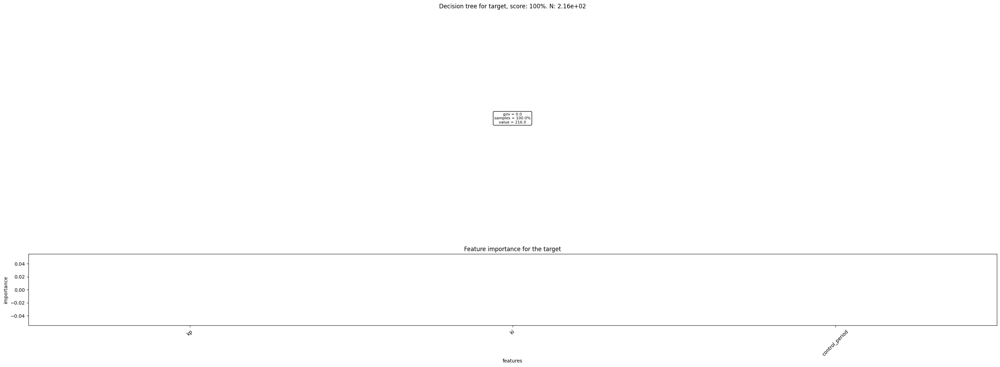

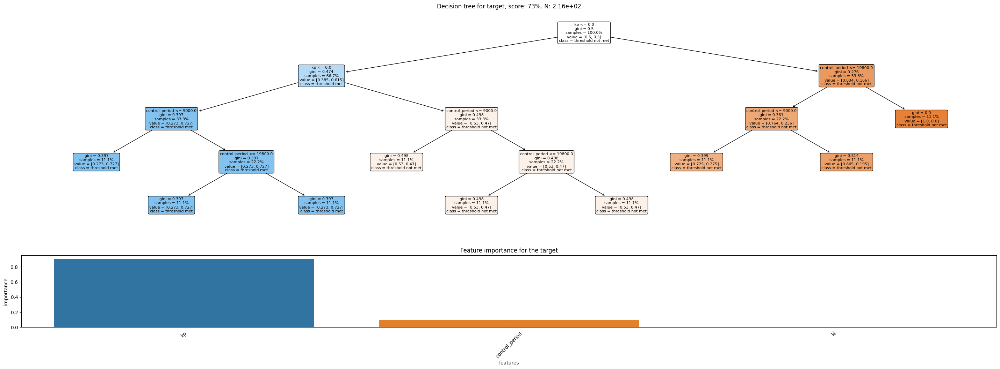

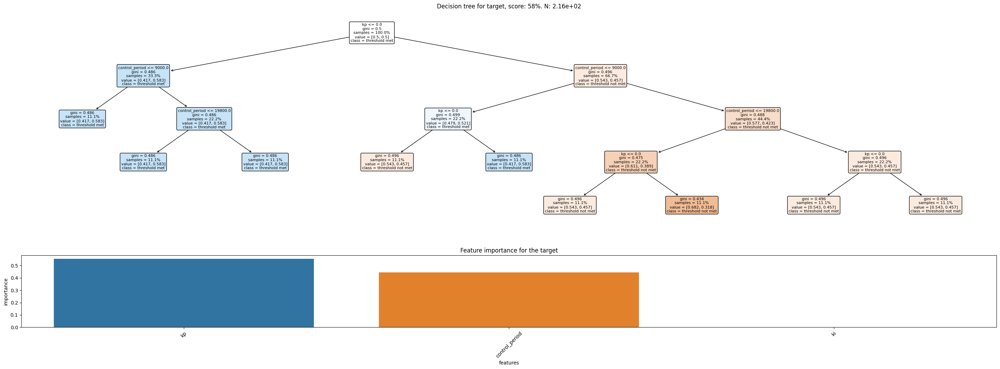

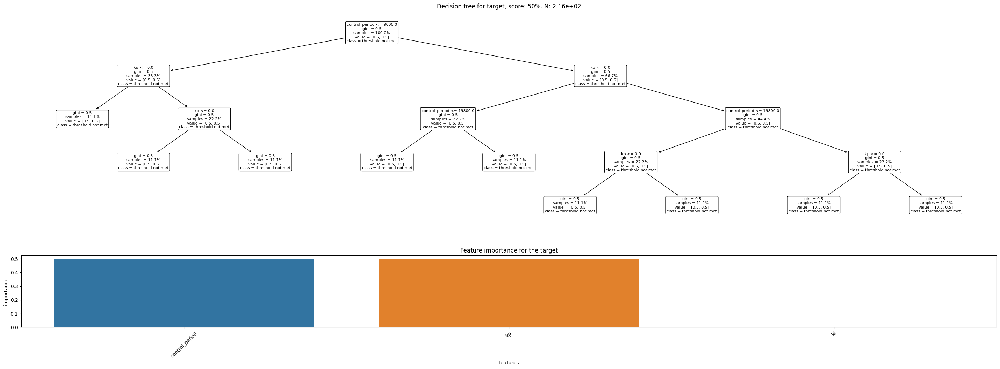

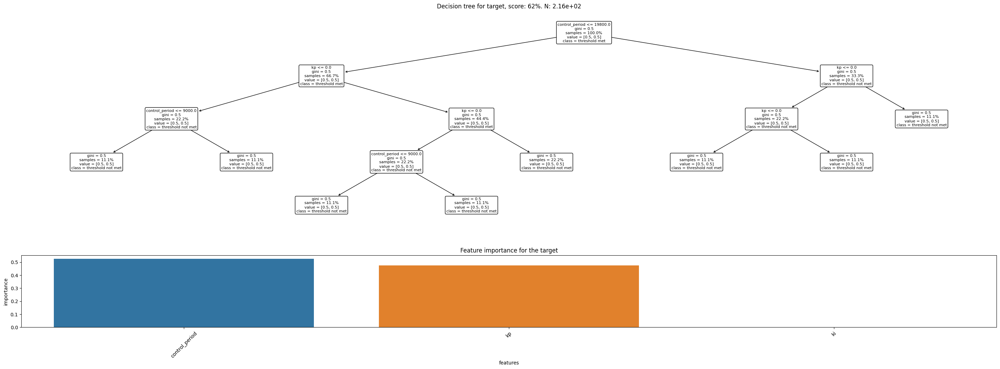

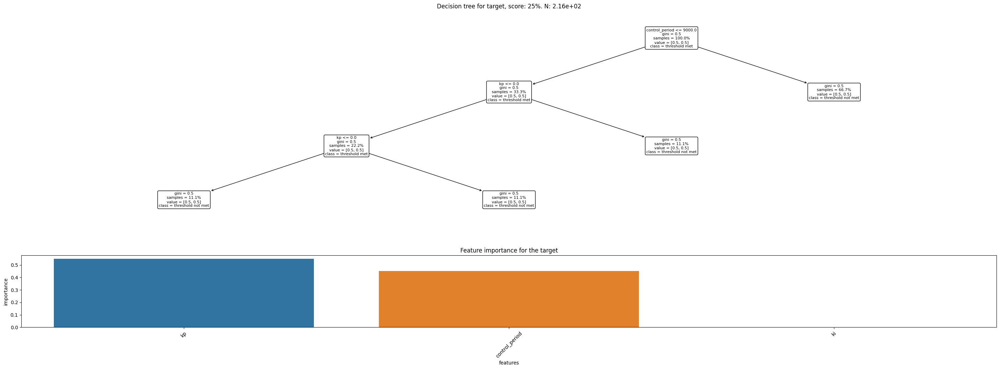

In [53]:
from cadcad_machine_search.visualizations import kpi_sensitivity_plot

goals = {
    'low_volatility'  : lambda metrics: metrics['kpi_volatility'].mean(),
    'high_stability'  : lambda metrics: metrics['kpi_stability'].mean(),
    'liquidity_threshold': lambda metrics: metrics['kpi_liquidity'].mean(),
}

# TODO: configure visualizations for analysis
for scenario in df_sensitivity['controller_enabled'].unique():
    _df = df_sensitivity.query(f'controller_enabled == {scenario}')
    for goal in goals:
        kpi_sensitivity_plot(_df, goals[goal], control_params)


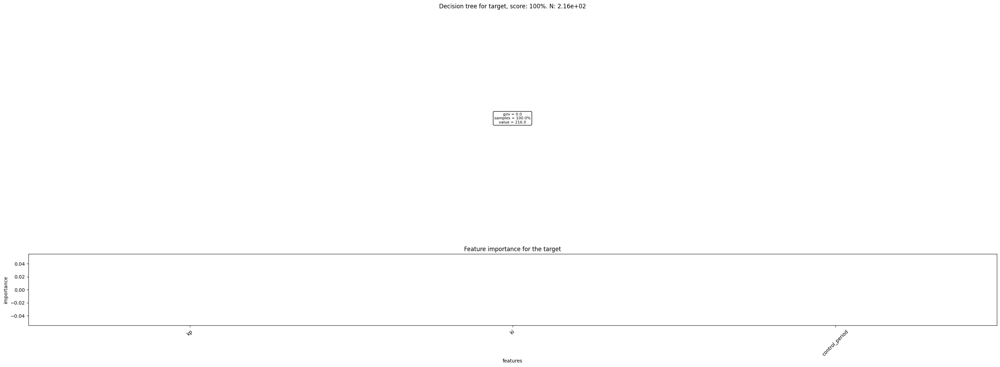

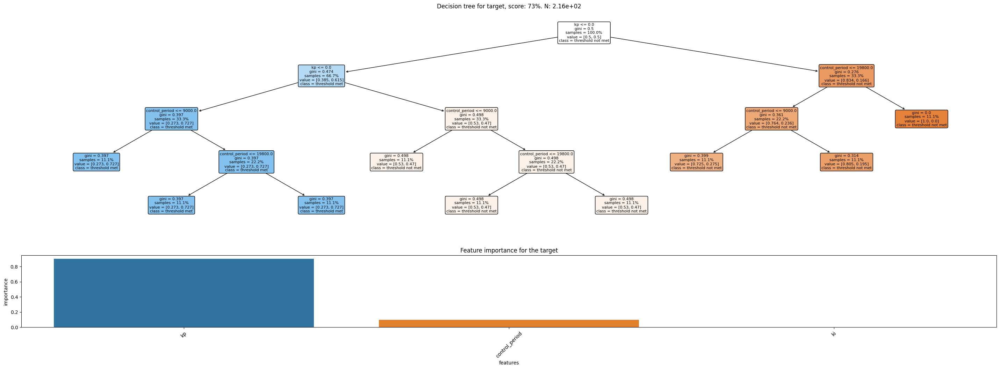

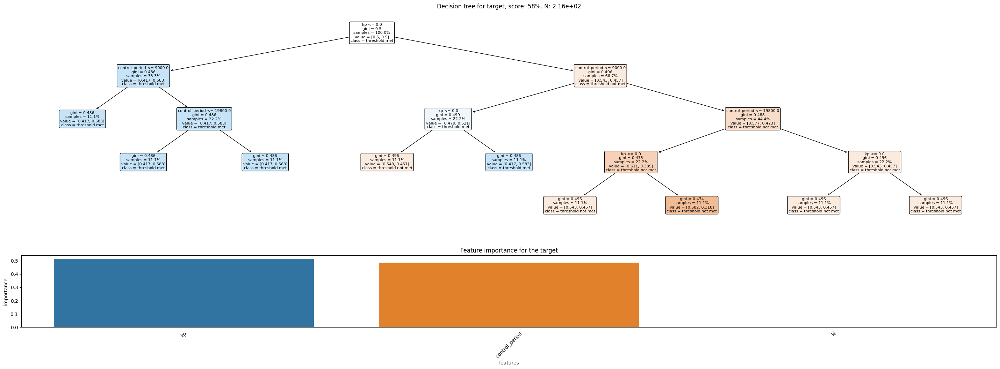

In [59]:
enabled = df_sensitivity.query(f'controller_enabled == True')
for goal in goals:
    kpi_sensitivity_plot(enabled, goals[goal], control_params)


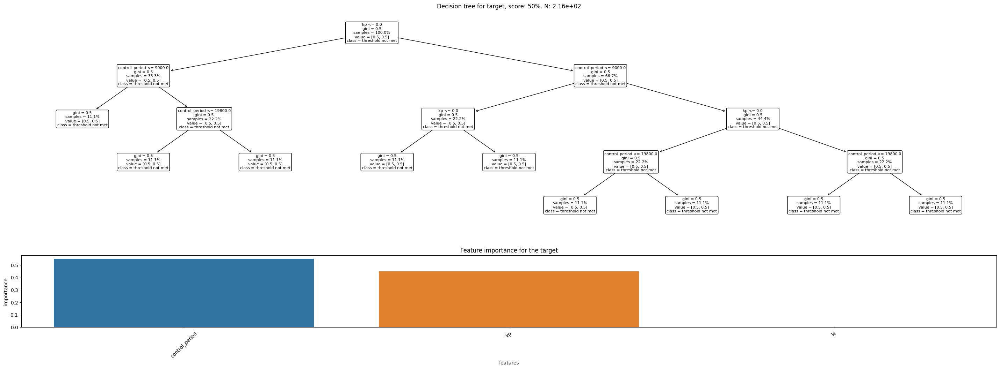

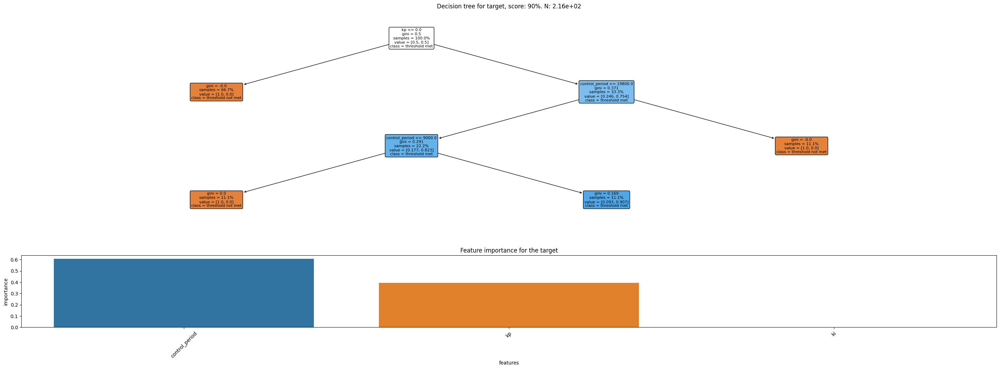

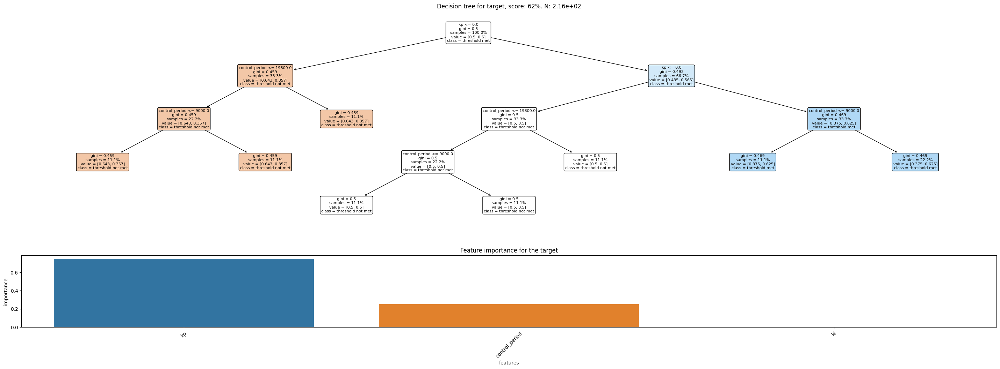

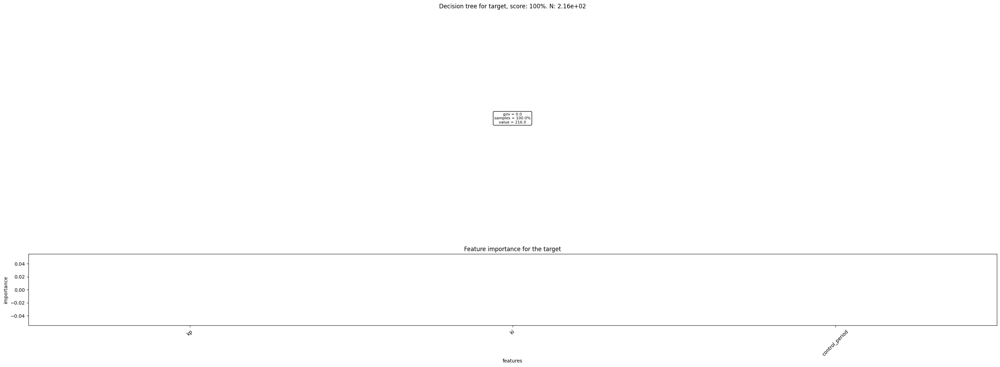

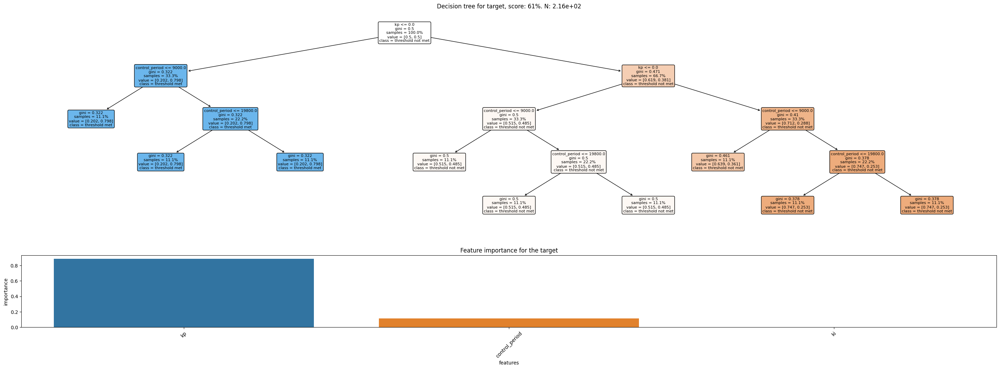

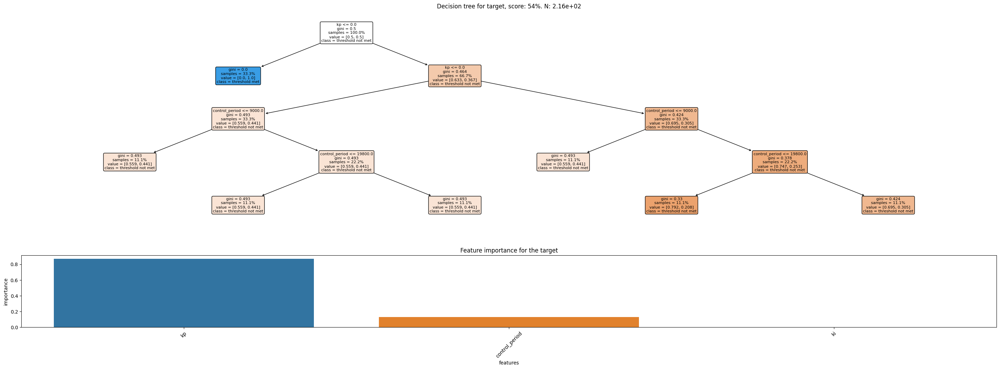

In [54]:
for scenario in df_sensitivity['liquidity_demand_shock'].unique():
    _df = df_sensitivity.query(f'liquidity_demand_shock == {scenario}')
    for goal in goals:
        kpi_sensitivity_plot(_df, goals[goal], control_params)

In [67]:
# TODO: resolve error `ValueError: operands could not be broadcast together with shapes (27,3) (4,) (27,3)`
from cadcad_machine_search.visualizations import plot_goal_ternary

kpis = {
    'volatility_simulation'        : lambda df: df['volatility_ratio_simulation'],
    'volatility_window_mean'       : lambda df: df['volatility_ratio_window'].mean(),
    'market_price_max'             : lambda df: df['market_price'].max(),
    'market_price_min'             : lambda df: df['market_price'].min(),
    'redemption_price_max'         : lambda df: df['target_price_scaled'].max(),
    'redemption_price_min'         : lambda df: df['target_price_scaled'].min(),
    'rai_balance_uniswap_min'      : lambda df: df['RAI_balance'].min(),
    'cdp_collateral_balance_min'   : lambda df: df['eth_collateral'].min(),
    'price_change_percentile_mean' : lambda df: critical_liquidity_threshold
}

goals = {
    'low_volatility' : lambda metrics: -0.5 * ( metrics['volatility_simulation'] +
                    metrics['price_change_percentile_mean'] ),
    'high_stability'  : lambda metrics: -(1/6) * ( metrics['market_price_max'] + 
                    1 / metrics['market_price_min'] + metrics['redemption_price_max'] +
                    1 / metrics['redemption_price_min'] + 1 / metrics['rai_balance_uniswap_min'] +
                    1 / metrics['cdp_collateral_balance_min'] ),
    'liquidity'  : lambda metrics: -metrics['price_change_percentile_mean'],
    'combined'   : lambda goals: goals[0] + goals[1] + goals[2]
}


for scenario in df_sensitivity['controller_enabled'].unique():
    _df = df_sensitivity.query(f'controller_enabled == {scenario}')
    plot_goal_ternary(_df, kpis, goals, control_params)


ValueError: operands could not be broadcast together with shapes (27,3) (4,) (27,3) 

# Control Parameter Analysis and Selection

In [68]:
df_liquidity_grouped = pd.read_pickle('experiments/system_model_v3/experiment_monte_carlo/df_liquidity_grouped.pickle')

In [69]:
# Create analysis dataframe, using liquidity grouped dataframe and sensitivity dataframe
df_sensitivity = pd.read_pickle('experiments/system_model_v3/experiment_monte_carlo/df_sensitivity.pickle')
df_analysis = df_sensitivity.groupby(['subset']).mean()
# Keep the difference of the columns
keep_cols = df_liquidity_grouped.columns.difference(df_analysis.columns)
df_analysis = pd.merge(df_analysis, df_liquidity_grouped[keep_cols], on=['subset'], how='inner')

In [70]:
# Select all runs that passed the KPIs
df_analysis = df_analysis.query('kpi_stability == True and kpi_volatility == True and kpi_liquidity == True')
df_analysis

,subset,index,timedelta,cumulative_time,eth_price,liquidity_demand,liquidity_demand_mean,eth_collateral,eth_locked,eth_freed,principal_debt,rai_drawn,rai_wiped,system_revenue,stability_fee,market_price,market_price_twap,target_price,target_rate,eth_return,eth_gross_return,expected_market_price,expected_debt_price,error_star,error_star_integral,market_slippage,RAI_balance,ETH_balance,UNI_supply,simulation,run,substep,timestep,eth_collateral_value,collateralization_ratio,ki,kp,liquidation_ratio,control_period,target_price_scaled,kpi_stability,kpi_volatility,kpi_liquidity,volatility_ratio_simulation,volatility_ratio_window,RAI_balance_max,RAI_balance_min,eth_collateral_max,eth_collateral_min,eth_price_std,kpi_volatility_simulation,kpi_volatility_window,level_2,market_price_max,market_price_min,market_price_std,market_slippage_abs,market_slippage_percentile,stability_cdp_system,stability_market_price,stability_target_price,stability_uniswap_liquidity,target_price_max,target_price_min,volatility_window_mean
4,4,10872.0,3599.16686,7776000.0,288.812867,-481.666728,-482.357805,78384.794753,154827.528922,76442.734168,1.015041e+07,5.940316e+07,4.925274e+07,0.0,1.585490e-10,2.471928,2.466946,1.541778,-4.431861e-08,5.821040e-07,0.999769,2.543304,3.14,-0.232059,-858.260979,-0.000847,7.241244e+06,63719.856442,6.407412e+06,0.0,1.0,17.995834,2160.0,2.255695e+07,1.450232,-5.000000e-09,2.000000e-07,1.45,3600.0,2.235579,True,True,True,0.049103,0.000199,2.339514e+07,4.203297e+06,154827.528922,45432.011104,13.206823,True,True,8712.0,4.335928,1.058915,0.648490,0.015090,0.022338,True,True,True,True,3.140000,1.088079,0.999954
5,5,15193.0,3599.16686,7776000.0,288.812867,-1257.650369,-1258.335889,68300.096142,154827.528922,86527.432780,1.186020e+07,6.055339e+07,4.869319e+07,0.0,1.585490e-10,1.897334,1.894529,1.232952,-1.162750e-07,5.821040e-07,0.999769,1.952294,3.14,-0.661696,-2448.211689,-0.000308,7.691517e+06,53448.277227,5.890809e+06,0.0,1.0,17.995834,2160.0,1.956652e+07,1.450608,-5.000000e-09,2.000000e-07,1.45,3600.0,1.787780,True,True,True,0.083823,0.000199,3.354728e+07,4.219811e+06,154827.528922,35664.162313,13.206823,True,True,13033.0,6.382268,0.663444,1.107033,0.015762,0.023811,True,True,True,True,3.140000,0.471447,0.999954
6,6,19514.0,3599.16686,7776000.0,288.812867,-96.211922,-96.795029,107525.440781,154827.528922,47302.088141,9.061827e+06,5.604023e+07,4.697840e+07,0.0,1.585490e-10,3.389584,3.378825,2.394547,1.882201e-08,5.821040e-07,0.999769,3.487474,3.14,0.091967,340.324136,-0.000950,6.789129e+06,77490.487174,6.859573e+06,0.0,1.0,17.995834,2160.0,3.105481e+07,1.449903,-5.000000e-09,2.000000e-07,1.45,3600.0,3.472093,True,True,True,0.057633,0.000199,1.620391e+07,3.829166e+06,154827.528922,44529.827447,13.123438,True,True,17354.0,5.262226,1.036636,0.756337,0.014634,0.021594,True,True,True,True,6.060897,1.490715,0.999951
7,7,23835.0,3599.16686,7776000.0,288.812867,-1086.787887,-1087.408963,79536.393192,154827.528922,75291.135730,1.136583e+07,6.071349e+07,4.934766e+07,0.0,1.585490e-10,1.978603,1.975411,1.452644,-8.960300e-08,5.821040e-07,0.999769,2.035875,3.14,-0.522947,-1934.662061,-0.001018,7.553752e+06,54583.159953,5.943205e+06,0.0,1.0,17.995834,2160.0,2.283403e+07,1.450469,-5.000000e-09,2.000000e-07,1.45,3600.0,2.106334,True,True,True,0.072978,0.000199,3.031935e+07,4.221176e+06,154827.528922,47889.510012,13.206823,True,True,21675.0,6.206049,0.729701,0.963804,0.016770,0.023804,True,True,True,True,3.140000,0.693835,1.000000
12,12,36708.0,3599.16686,7776000.0,288.812867,-489.609698,-490.300588,78133.969826,154827.528922,76693.559096,1.016952e+07,5.948181e+07,4.931229e+07,0.0,1.585490e-10,2.459426,2.454407,1.534323,-4.498116e-08,5.821040e-07,0.999769,2.530442,3.14,-0.230326,-851.838966,-0.000925,7.246743e+06,63473.398269,6.396414e+06,0.0,1.0,17.995834,2160.0,2.248385e+07,1.450236,-5.000000e-09,2.000000e-07,1.45,14400.0,2.224769,True,True,True,0.049220,0.000199,2.345377e+07,4.194087e+06,154827.528922,45625.758516,13.206823,True,True,34548.0,4.335

In [71]:
# Save interim results
df_analysis.to_pickle('experiments/system_model_v3/experiment_monte_carlo/df_analysis.pickle')

# Subset KPI Ranking

In [72]:
def map_params(df, params, set_params):
    '''
    Sets the parameters for each subset in the dataframe
    '''
    param_sweep = generate_parameter_sweep(params)
    param_sweep = [{param: subset[param] for param in set_params} for subset in param_sweep]
    for subset_index in df['subset'].unique():
        for (key, value) in param_sweep[subset_index].items():
            df.loc[df.eval(f'subset == {subset_index}'), key] = value

In [73]:
# Select which parameters to set in the dataframe for each subset
set_params = [
    'ki',
    'kp',
    'alpha',
    'liquidation_ratio',
    'controller_enabled',
    'control_period',
    'liquidity_demand_shock',
    'arbitrageur_considers_liquidation_ratio',
    'rescale_target_price'
]

In [74]:
# Assign parameters to subsets
map_params(df_analysis, params, set_params)

In [75]:
# Select subsets where the controller was enabled
df_controller_enabled = df_analysis.query('controller_enabled == True')

## Volatility KPI Ranking

Rank the subsets that meet all KPIs according to the volatility KPI measure.

In [76]:
%%capture
lambda_volatility_measure = lambda x: -0.5 * (x + critical_liquidity_threshold)
df_controller_enabled['kpi_volatility_measure'] = df_controller_enabled['volatility_ratio_simulation'].apply(lambda_volatility_measure)

In [77]:
df_volatility_measure = df_controller_enabled.groupby(['subset']).agg({
    'kpi_volatility_measure': lambda x: x.mean(skipna=True),
    'kp': 'first',
    'ki': 'first',
    'control_period': 'first',
}).sort_values(by='kpi_volatility_measure', kind="mergesort", ascending=False)
df_volatility_measure

,kpi_volatility_measure,kp,ki,control_period
subset,,,,
4,-0.040326,2.000000e-07,-5.000000e-09,3600.0
28,-0.040335,2.000000e-07,-1.000000e-09,3600.0
52,-0.040337,2.000000e-07,-2.000000e-10,3600.0
12,-0.040384,2.000000e-07,-5.000000e-09,14400.0
36,-0.040388,2.000000e-07,-1.000000e-09,14400.0
...,...,...,...,...
29,-0.057715,2.000000e-07,-1.000000e-09,3600.0
53,-0.057720,2.000000e-07,-2.000000e-10,3600.0
134,-0.058138,1.000000e-06,-2.000000e-10,14400.0


In [78]:
df[df['subset'].isin(list(df_volatility_measure.index)[:10])].query('run == 1').plot(
    title='Market price of top 10 subsets ranked according to volatility KPI measure',
    x='timestamp', y='market_price', color='subset'
)

## Stability KPI Ranking

Rank the subsets that meet all KPIs according to the stability KPI measure.

In [79]:
%%capture
lambda_stability_measure = lambda x: -(1/6) * ( x['market_price_max'] + 
                    1 / x['market_price_min'] + x['target_price_max'] +
                    1 / x['target_price_min'] + 1 / x['RAI_balance_min'] +
                    1 / x['eth_collateral_min'] )

df_controller_enabled['kpi_stability_measure'] = df_controller_enabled.apply(lambda_stability_measure, axis=1)

In [80]:
df_stability_measure = df_controller_enabled.groupby(['subset']).agg({
    'kpi_stability_measure': lambda x: x.mean(skipna=True),
    'kp': 'first',
    'ki': 'first',
    'alpha': 'first',
    'control_period': 'first',
}).sort_values(by='kpi_stability_measure', kind="mergesort", ascending=False)
df_stability_measure

,kpi_stability_measure,kp,ki,alpha,control_period
subset,,,,,
4,-1.556561,2.000000e-07,-5.000000e-09,9.990000e+26,3600.0
28,-1.558138,2.000000e-07,-1.000000e-09,9.990000e+26,3600.0
20,-1.558434,2.000000e-07,-5.000000e-09,9.990000e+26,25200.0
52,-1.558449,2.000000e-07,-2.000000e-10,9.990000e+26,3600.0
12,-1.558463,2.000000e-07,-5.000000e-09,9.990000e+26,14400.0
...,...,...,...,...,...
102,-6.885533,1.000000e-06,-1.000000e-09,9.990000e+26,3600.0
94,-6.886355,1.000000e-06,-5.000000e-09,9.990000e+26,25200.0
150,-6.929463,5.000000e-06,-5.000000e-09,9.990000e+26,3600.0


In [81]:
df[df['subset'].isin(list(df_stability_measure.index)[:10])].query('run == 1').plot(
    title='Market price of top 10 subsets ranked according to stability KPI measure',
    x='timestamp', y='market_price', color='subset'
)

## Liquidity KPI Ranking

Rank the subsets that meet all KPIs according to the liquidity KPI measure.

In [82]:
df_liquidity_measure = df_controller_enabled.groupby(['subset']).agg({
    'market_slippage_percentile': lambda x: x.mean(skipna=True),
    'kp': 'first',
    'ki': 'first',
    'alpha': 'first',
    'control_period': 'first',
}).sort_values(by='market_slippage_percentile', kind="mergesort")
df_liquidity_measure

,market_slippage_percentile,kp,ki,alpha,control_period
subset,,,,,
94,0.021284,0.000001,-5.000000e-09,9.990000e+26,25200.0
118,0.021286,0.000001,-1.000000e-09,9.990000e+26,25200.0
142,0.021286,0.000001,-2.000000e-10,9.990000e+26,25200.0
78,0.021292,0.000001,-5.000000e-09,9.990000e+26,3600.0
102,0.021305,0.000001,-1.000000e-09,9.990000e+26,3600.0
...,...,...,...,...,...
108,0.024737,0.000001,-1.000000e-09,9.990000e+26,14400.0
132,0.024738,0.000001,-2.000000e-10,9.990000e+26,14400.0
150,0.029857,0.000005,-5.000000e-09,9.990000e+26,3600.0


In [83]:
df[df['subset'].isin(list(df_liquidity_measure.index)[:10])].query('run == 1').plot(
    title='Market price of top 10 subsets ranked according to liquidity KPI measure',
    x='timestamp', y='market_price', color='subset'
)

## Aggregate KPI rankings

In [84]:
# Find intersection of top 25 of each KPI measure
subset_kpi_indexes = df_stability_measure.index[:25].intersection(df_liquidity_measure.index[:25]).intersection(df_volatility_measure.index[:25])
subset_kpi_selection = list(subset_kpi_indexes)
subset_kpi_selection

[4, 28, 20, 44, 68, 36, 60]

In [85]:
df_selection = df_controller_enabled[df_controller_enabled['subset'].isin(subset_kpi_selection)]
df_selection

,subset,index,timedelta,cumulative_time,eth_price,liquidity_demand,liquidity_demand_mean,eth_collateral,eth_locked,eth_freed,principal_debt,rai_drawn,rai_wiped,system_revenue,stability_fee,market_price,market_price_twap,target_price,target_rate,eth_return,eth_gross_return,expected_market_price,expected_debt_price,error_star,error_star_integral,market_slippage,RAI_balance,ETH_balance,UNI_supply,simulation,run,substep,timestep,eth_collateral_value,collateralization_ratio,ki,kp,liquidation_ratio,control_period,target_price_scaled,kpi_stability,kpi_volatility,kpi_liquidity,volatility_ratio_simulation,volatility_ratio_window,RAI_balance_max,RAI_balance_min,eth_collateral_max,eth_collateral_min,eth_price_std,kpi_volatility_simulation,kpi_volatility_window,level_2,market_price_max,market_price_min,market_price_std,market_slippage_abs,market_slippage_percentile,stability_cdp_system,stability_market_price,stability_target_price,stability_uniswap_liquidity,target_price_max,target_price_min,volatility_window_mean,alpha,controller_enabled,liquidity_demand_shock,arbitrageur_considers_liquidation_ratio,rescale_target_price,kpi_volatility_measure,kpi_stability_measure
4,4,10872.0,3599.16686,7776000.0,288.812867,-481.666728,-482.357805,78384.794753,154827.528922,76442.734168,1.015041e+07,5.940316e+07,4.925274e+07,0.0,1.585490e-10,2.471928,2.466946,1.541778,-4.431861e-08,5.821040e-07,0.999769,2.543304,3.14,-0.232059,-858.260979,-0.000847,7.241244e+06,63719.856442,6.407412e+06,0.0,1.0,17.995834,2160.0,2.255695e+07,1.450232,-5.000000e-09,2.000000e-07,1.45,3600.0,2.235579,True,True,True,0.049103,0.000199,2.339514e+07,4.203297e+06,154827.528922,45432.011104,13.206823,True,True,8712.0,4.335928,1.058915,0.648490,0.015090,0.022338,True,True,True,True,3.14,1.088079,0.999954,9.990000e+26,True,False,True,True,-0.040326,-1.556561
20,20,62463.0,3599.16686,7776000.0,288.812867,-489.879179,-490.570174,78141.119463,154827.528922,76686.409459,1.016959e+07,5.948098e+07,4.931138e+07,0.0,1.585490e-10,2.459563,2.454543,1.534444,-4.498810e-08,5.821040e-07,0.999769,2.530584,3.14,-0.230287,-851.695485,-0.000925,7.246107e+06,63471.447235,6.396037e+06,0.0,1.0,17.995834,2160.0,2.248591e+07,1.450236,-5.000000e-09,2.000000e-07,1.45,25200.0,2.224944,True,True,True,0.049245,0.000199,2.345833e+07,4.191686e+06,154827.528922,45615.836878,13.206823,True,True,60303.0,4.335928,1.053247,0.650363,0.015177,0.022340,True,True,True,True,3.14,1.080838,0.999954,9.990000e+26,True,False,True,True,-0.040397,-1.558434
28,28,88375.0,3599.16686,7776000.0,288.812867,-488.748676,-489.439305,78238.667049,154827.528922,76588.861873,1.016589e+07,5.946705e+07,4.930116e+07,0.0,1.585490e-10,2.462241,2.457207,1.536800,-4.475150e-08,5.821040e-07,0.999769,2.533337,3.14,-0.229537,-848.918220,-0.000926,7.243991e+06,63525.061939,6.398321e+06,0.0,1.0,17.995834,2160.0,2.251436e+07,1.450235,-1.000000e-09,2.000000e-07,1.45,3600.0,2.228359,True,True,True,0.049120,0.000199,2.345561e+07,4.207182e+06,154827.528922,45616.708283,13.206823,True,True,86215.0,4.335928,1.053809,0.648722,0.015178,0.022366,True,True,True,True,3.14,1.082325,0.999954,9.990000e+26,True,False,True,True,-0.040335,-1.558138
36,36,114210.0,3599.16686,7776000.0,288.812867,-491.366505,-492.057308,78095.435686,154827.528922,76732.093236,1.017347e+07,5.949911e+07,4.932564e+07,0.0,1.585490e-10,2.456962,2.451951,1.533037,-4.509588e-08,5.821040e-07,0.999769,2.527908,3.14,-0.229736,-849.653559,-0.000925,7.247539e+06,63424.381579,6.394149e+06,0.0,1.0,17.995834,2160.0,2.247262e+07,1.450236,-1.000000e-09,2.000000e-07,1.45,14400.0,2.222903,True,True,True,0.049226,0.000199,2.347124e+07,4.195287e+06,154827.528922,45632.096664,13.206823,True,True,112050.0,4.335928,1.051851,0.650117,0.015180,0.022365,True,True,True,True,3.14,1.079363,0.999954,9.990000e+26,True,False,True,True,-0.040388,-1.558854
44,44,139965.0,3599.16686,7776000.0,288.812867,-490.879790,-491.570735,78119.114562,154827.528922,76708.414360,1.017185e+07,5.949084e+07,4.931899e+07,0.0,1.585490e-10,

In [86]:
# Select all dataframes with the control_period less than 25200
df_selection = df_selection.query('control_period < 25200')
df_selection

,subset,index,timedelta,cumulative_time,eth_price,liquidity_demand,liquidity_demand_mean,eth_collateral,eth_locked,eth_freed,principal_debt,rai_drawn,rai_wiped,system_revenue,stability_fee,market_price,market_price_twap,target_price,target_rate,eth_return,eth_gross_return,expected_market_price,expected_debt_price,error_star,error_star_integral,market_slippage,RAI_balance,ETH_balance,UNI_supply,simulation,run,substep,timestep,eth_collateral_value,collateralization_ratio,ki,kp,liquidation_ratio,control_period,target_price_scaled,kpi_stability,kpi_volatility,kpi_liquidity,volatility_ratio_simulation,volatility_ratio_window,RAI_balance_max,RAI_balance_min,eth_collateral_max,eth_collateral_min,eth_price_std,kpi_volatility_simulation,kpi_volatility_window,level_2,market_price_max,market_price_min,market_price_std,market_slippage_abs,market_slippage_percentile,stability_cdp_system,stability_market_price,stability_target_price,stability_uniswap_liquidity,target_price_max,target_price_min,volatility_window_mean,alpha,controller_enabled,liquidity_demand_shock,arbitrageur_considers_liquidation_ratio,rescale_target_price,kpi_volatility_measure,kpi_stability_measure
4,4,10872.0,3599.16686,7776000.0,288.812867,-481.666728,-482.357805,78384.794753,154827.528922,76442.734168,1.015041e+07,5.940316e+07,4.925274e+07,0.0,1.585490e-10,2.471928,2.466946,1.541778,-4.431861e-08,5.821040e-07,0.999769,2.543304,3.14,-0.232059,-858.260979,-0.000847,7.241244e+06,63719.856442,6.407412e+06,0.0,1.0,17.995834,2160.0,2.255695e+07,1.450232,-5.000000e-09,2.000000e-07,1.45,3600.0,2.235579,True,True,True,0.049103,0.000199,2.339514e+07,4.203297e+06,154827.528922,45432.011104,13.206823,True,True,8712.0,4.335928,1.058915,0.648490,0.015090,0.022338,True,True,True,True,3.14,1.088079,0.999954,9.990000e+26,True,False,True,True,-0.040326,-1.556561
28,28,88375.0,3599.16686,7776000.0,288.812867,-488.748676,-489.439305,78238.667049,154827.528922,76588.861873,1.016589e+07,5.946705e+07,4.930116e+07,0.0,1.585490e-10,2.462241,2.457207,1.536800,-4.475150e-08,5.821040e-07,0.999769,2.533337,3.14,-0.229537,-848.918220,-0.000926,7.243991e+06,63525.061939,6.398321e+06,0.0,1.0,17.995834,2160.0,2.251436e+07,1.450235,-1.000000e-09,2.000000e-07,1.45,3600.0,2.228359,True,True,True,0.049120,0.000199,2.345561e+07,4.207182e+06,154827.528922,45616.708283,13.206823,True,True,86215.0,4.335928,1.053809,0.648722,0.015178,0.022366,True,True,True,True,3.14,1.082325,0.999954,9.990000e+26,True,False,True,True,-0.040335,-1.558138
36,36,114210.0,3599.16686,7776000.0,288.812867,-491.366505,-492.057308,78095.435686,154827.528922,76732.093236,1.017347e+07,5.949911e+07,4.932564e+07,0.0,1.585490e-10,2.456962,2.451951,1.533037,-4.509588e-08,5.821040e-07,0.999769,2.527908,3.14,-0.229736,-849.653559,-0.000925,7.247539e+06,63424.381579,6.394149e+06,0.0,1.0,17.995834,2160.0,2.247262e+07,1.450236,-1.000000e-09,2.000000e-07,1.45,14400.0,2.222903,True,True,True,0.049226,0.000199,2.347124e+07,4.195287e+06,154827.528922,45632.096664,13.206823,True,True,112050.0,4.335928,1.051851,0.650117,0.015180,0.022365,True,True,True,True,3.14,1.079363,0.999954,9.990000e+26,True,False,True,True,-0.040388,-1.558854
60,60,191737.0,3599.16686,7776000.0,288.812867,-491.717148,-492.407934,78087.756975,154827.528922,76739.771947,1.017426e+07,5.950256e+07,4.932830e+07,0.0,1.585490e-10,2.456471,2.451462,1.532780,-4.511876e-08,5.821040e-07,0.999769,2.527403,3.14,-0.229618,-849.218934,-0.000925,7.247697e+06,63414.611559,6.393697e+06,0.0,1.0,17.995834,2160.0,2.247038e+07,1.450236,-2.000000e-10,2.000000e-07,1.45,14400.0,2.222531,True,True,True,0.049227,0.000199,2.347474e+07,4.195527e+06,154827.528922,45633.359744,13.206823,True,True,189577.0,4.335928,1.051600,0.650134,0.015181,0.022365,True,True,True,True,3.14,1.079081,0.999954,9.990000e+26,True,False,True,True,-0.040388,-1.558933


In [106]:
df_selection_timeseries = df[df['subset'].isin(list(df_selection.index))]

## Subset 4 time series

In [88]:
df_controller_enabled.query('subset == 4')[['kp', 'ki', 'control_period', 'alpha']]

,kp,ki,control_period,alpha
4,2.000000e-07,-5.000000e-09,3600.0,9.990000e+26


In [89]:
df_selection_timeseries.query('subset == 4').plot(x='timestamp', y='market_price', color='run')

In [90]:
df_selection_timeseries.query('subset == 4').plot(x='timestamp', y=['market_price_twap'], color='run')

In [91]:
df_selection_timeseries.query('subset == 4').plot(x='timestamp', y=['target_price_scaled'], color='run')

## Conclusion